## Part 2: 

### 4. Data Preprocessing
    a. Missing Values
    b. Outliers
    c. Feature Engineering 
    d. Categorical Encoding 
    e. Features Scaling 
    f. Cross-Validation
    
###  5. Models Selection 

###  6. Model Evaluation 


In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set(style="darkgrid")
import cufflinks as cf

import plotly.offline as py 
import plotly.figure_factory as ff 
import plotly.graph_objs as go 

from plotly import tools 
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot, plot 

py.init_notebook_mode(connected= True)
cf.go_offline()

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Importing the Data set 
df = pd.read_csv("loan.csv", low_memory=False)

In [48]:
# 
num_col = df.select_dtypes(include=("int64", "float64"))

In [3]:
states = []
def uni_item(col):
    for state in col:
        if state not in states:
            states.append(state)
    return(states)

us_states = uni_item(df["addr_state"])

## 4. Data Preprocessing 

### 4.1. Missing Values 

 **Step 1** 
Let's check what is the overal percentage of missing values in our data set. To do that first we have to  count the total missing values and then divide those by total number of cells. 

we have **887379 number of observations** and **74 number of columns**

In [4]:
total = np.product(df.shape) # total will be 65666046
miss_values = df.isnull().sum().sum() # Total missing values are 17998490

In [5]:
per_total = (miss_values/total)*100
print(f"The total percentage of missing values in data set is {(per_total)}")

The total percentage of missing values in data set is 27.409127085251946


The percent of missing values in our entire data set is **27.401 %**

#### How many columns have missing values? 

In [6]:
print(df.isnull().any().value_counts(), "\n")

print(f"The columns that have missing values are total {df.isnull().any().sum()}")

True     40
False    34
dtype: int64 

The columns that have missing values are total 40


**40 columns** have missing values 

**Step 2** 
Creating a Data Frame of the columns having missing values with the percentage and total number of misisng values.

In [7]:
total_num = df.isnull().sum().sort_values(ascending=False)

perc = df.isnull().sum()/df.isnull().count() *100
perc1 = (round(perc,2).sort_values(ascending=False))

# Creating a data frame:
df_miss = pd.concat([total_num, perc1], axis =1 , keys =["Total Missing Values", "Percentage %"]).sort_values(by ="Percentage %", ascending = False)

In [8]:
top_mis = df_miss[df_miss["Percentage %"]>0]
top_mis

,Total Missing Values,Percentage %
dti_joint,886870,99.94
verification_status_joint,886868,99.94
annual_inc_joint,886868,99.94
il_util,868762,97.90
mths_since_rcnt_il,866569,97.65
inq_last_12m,866007,97.59
total_bal_il,866007,97.59
total_cu_tl,866007,97.59
max_bal_bc,866007,97.59
open_acc_6m,866007,97.59


#### Above table shows our which features has maximum missing values in descending order. 

**Step 3** 

Visualising the missing values in each column for better understanding:

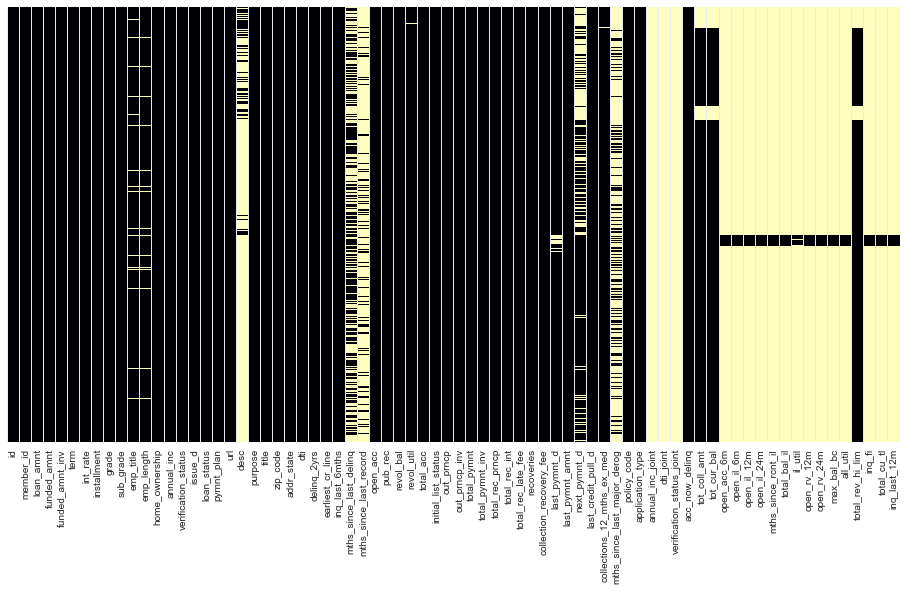

In [9]:
plt.figure(figsize=(16,8))
sns.heatmap(df.isnull(), cbar = False, yticklabels=False, cmap="magma" )

#### Above heatmap shows how many values are missing in every columns. All the light colored columns represents the amount of missing values present in that specific column. 

Text(0,0.5,'% missing data')

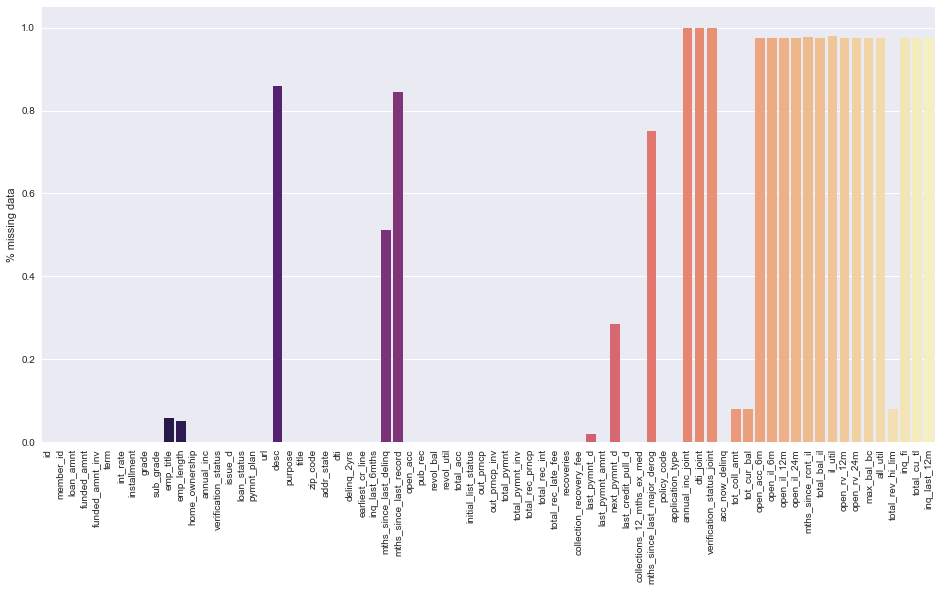

In [10]:
null_perc = df.isnull().sum()/df.isnull().count()

plt.figure(figsize=(16,8))

sns.barplot(x = np.arange(len(null_perc)), y =null_perc, palette="magma")

plt.xticks(np.arange(len(null_perc)),null_perc.index,rotation=90)
plt.ylabel('% missing data')

In [11]:
# Creating a bar chart: 

trace = go.Bar(x = top_mis.index, y = top_mis["Percentage %"],
              marker =dict(color= df["int_rate"], colorscale = "Jet"))

layout = go.Layout(title = "Missing Values", yaxis=dict(title = "Percentage %"))

data = [trace]

fig = go.Figure(data = data, layout=layout)
py.iplot(fig)

We will be droping all the columns which have missing values more than 80% in our next step. However, it is always recommended to do some research about the specific features. And, come up with hypothesis that why they were not recorded or they don't exists? 

In addition to that, there are several ways to replace them (imputation) and other techniques to fill up the minor missing values with potential statistics techniques.

I will be going through some basic ones during the next stage.

### 4.2. Handling Missing Values: 


**Step 1** Droping all the columns which have missing values more than 80% and the redundant columns

In [12]:
df.drop(top_mis[top_mis["Percentage %"]>75].index, axis = 1, inplace=True)

Dropping columns based on their redundancy.

In [13]:
df.drop(["policy_code", "next_pymnt_d", "id", "member_id", "emp_title","url",
        "mths_since_last_delinq"]
        , axis = 1, inplace=True)

### In order to avoid multicolinearity. We will deleting columns which are highly correlated to one and another. 

**Step 2** Droping columns based on multicolinearity

In [29]:
# Lets look at funded amount column and its correlation with other columns 
df.corr()["funded_amnt"].sort_values(ascending =False).head(10)

funded_amnt        1.000000
loan_amnt          0.999263
funded_amnt_inv    0.998025
installment        0.946005
out_prncp_inv      0.648839
out_prncp          0.648838
total_rec_int      0.532864
total_pymnt_inv    0.474502
total_pymnt        0.473286
total_rec_prncp    0.389242
Name: funded_amnt, dtype: float64

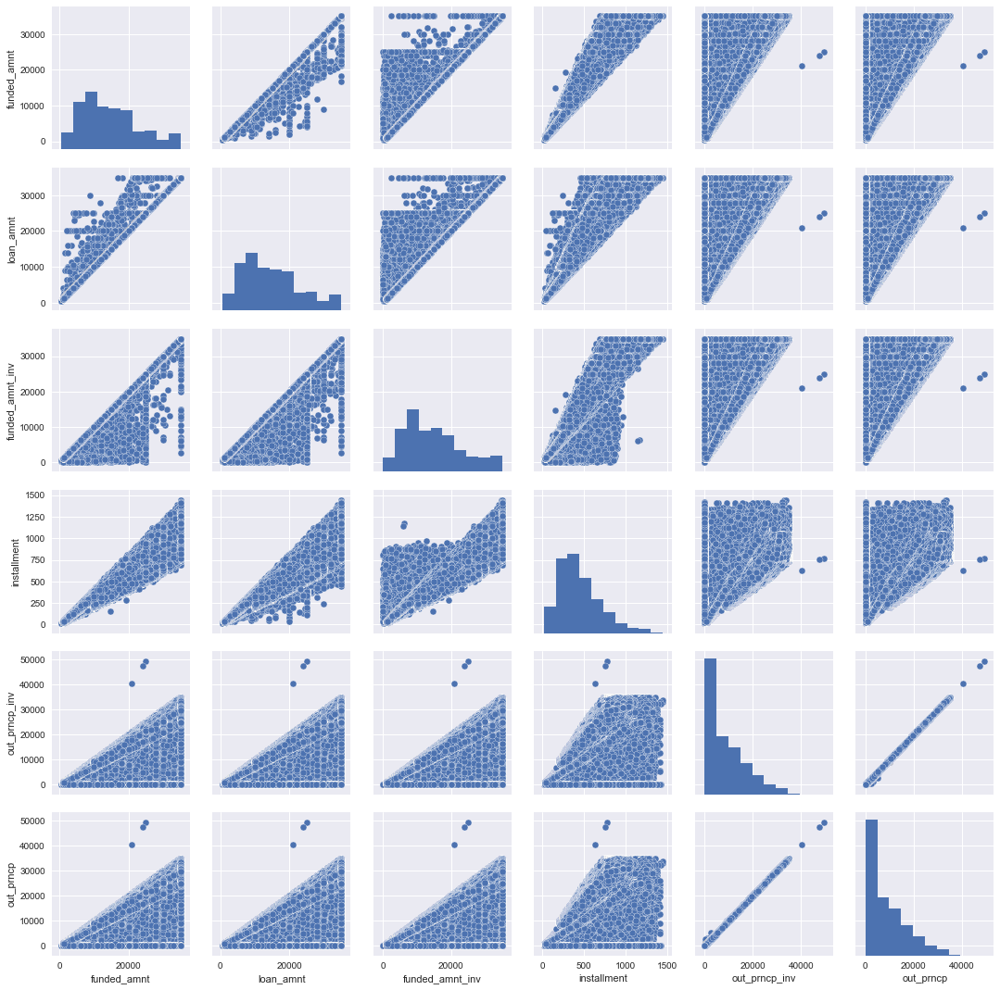

In [30]:
sns.pairplot(df[["funded_amnt","loan_amnt","funded_amnt_inv","installment","out_prncp_inv","out_prncp"]])

#### Looks like a lot of features are **highly correlated with each and other**. Therefore let's get in more depth and remove all the features who are hihly correlated one and other in order to **multicolinearity and overfitting our model with redundant features. 

In [37]:
def ind_corr(cols):
    for col in cols:
        print(df.corr()[col].sort_values(ascending =False).head(10), "\n")

In [56]:
ind_corr(num_col.columns)

loan_amnt          1.000000
funded_amnt        0.999263
funded_amnt_inv    0.997115
installment        0.944977
out_prncp_inv      0.646898
out_prncp          0.646897
total_rec_int      0.533916
total_pymnt_inv    0.475655
total_pymnt        0.474626
total_rec_prncp    0.390473
Name: loan_amnt, dtype: float64 

funded_amnt        1.000000
loan_amnt          0.999263
funded_amnt_inv    0.998025
installment        0.946005
out_prncp_inv      0.648839
out_prncp          0.648838
total_rec_int      0.532864
total_pymnt_inv    0.474502
total_pymnt        0.473286
total_rec_prncp    0.389242
Name: funded_amnt, dtype: float64 

funded_amnt_inv    1.000000
funded_amnt        0.998025
loan_amnt          0.997115
installment        0.943632
out_prncp_inv      0.651556
out_prncp          0.651545
total_rec_int      0.530382
total_pymnt_inv    0.474062
total_pymnt        0.468848
total_rec_prncp    0.384877
Name: funded_amnt_inv, dtype: float64 

int_rate           1.000000
total_rec_int      0.4

acc_now_delinq                1.000000
delinq_2yrs                   0.130326
collections_12_mths_ex_med    0.039644
int_rate                      0.026478
total_acc                     0.026461
tot_cur_bal                   0.023394
open_acc                      0.017752
annual_inc                    0.014775
out_prncp                     0.012387
out_prncp_inv                 0.012379
Name: acc_now_delinq, dtype: float64 

tot_coll_amt                  1.000000
collections_12_mths_ex_med    0.009811
pub_rec                       0.006891
total_acc                     0.006525
inq_last_6mths                0.003171
int_rate                      0.001130
annual_inc                    0.001096
acc_now_delinq                0.000237
delinq_2yrs                   0.000207
open_acc                      0.000124
Name: tot_coll_amt, dtype: float64 

tot_cur_bal         1.000000
revol_bal           0.442036
annual_inc          0.418332
total_rev_hi_lim    0.384609
funded_amnt_inv     0.328804

In [61]:
# Therefore, In order to avoid multicolinearity. We have to drop furhter columns: 
df.drop(["funded_amnt","funded_amnt_inv","out_prncp_inv", "total_pymnt_inv", "open_acc", "total_rev_hi_lim", 
        "total_pymnt","collection_recovery_fee"], axis = 1, inplace = True)

In [64]:
# total_acc	The total number of credit lines currently in the borrower's credit file
# open_acc	The number of open credit lines in the borrower's credit file.

# revol_bal	Total credit revolving balance
# total_rev_hi_lim  	Total revolving high credit/credit limit
#total_rev_hi_lim    1.000000
#revol_bal           0.821189

# out_prncp_inv       1.000000
# out_prncp           0.999997


#total_rec_prncp    1.000000
#total_pymnt        0.970043
#total_pymnt_inv    0.967496


#recoveries                 1.000000
#collection_recovery_fee    0.802420

#loan_amnt          1.000000
#funded_amnt        0.999263
#funded_amnt_inv    0.997115

In [78]:
df.isnull().sum().sort_values(ascending = False).head(15)

tot_cur_bal                   70276
tot_coll_amt                  70276
emp_length                    44825
last_pymnt_d                  17659
revol_util                      502
title                           152
collections_12_mths_ex_med      145
last_credit_pull_d               53
total_acc                        29
delinq_2yrs                      29
inq_last_6mths                   29
pub_rec                          29
earliest_cr_line                 29
acc_now_delinq                   29
annual_inc                        4
dtype: int64

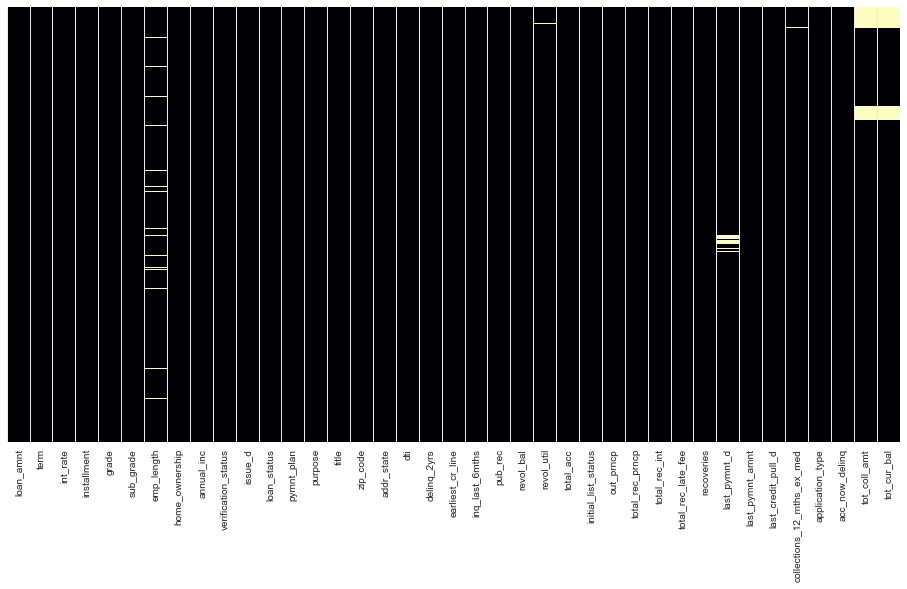

In [65]:
plt.figure(figsize=(16,8))
sns.heatmap(df.isnull(), cbar = False, yticklabels=False, cmap="magma" )

In [71]:
df["emp_length"].value_counts()

10+ years    291569
2 years       78870
< 1 year      70605
3 years       70026
1 year        57095
5 years       55704
4 years       52529
7 years       44594
8 years       43955
6 years       42950
9 years       34657
Name: emp_length, dtype: int64

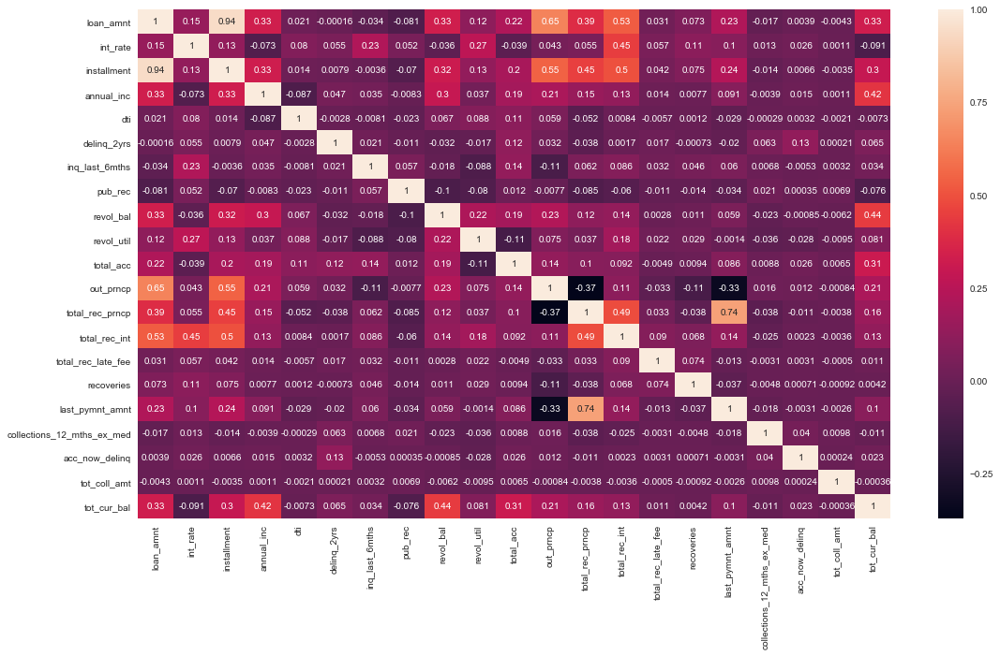

In [63]:
plt.figure(figsize=(18,10))
sns.heatmap(df.corr(), annot=True)

In [31]:
df.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'purpose', 'title', 'zip_code', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'application_type', 'acc_now_delinq',
       'tot_coll_amt', 'tot_cur_bal', 'total_rev_hi_lim'],
      dtype='object')

In [22]:
df.corr()["funded_amnt"].sort_values(ascending =False).head(10)

funded_amnt        1.000000
loan_amnt          0.999263
funded_amnt_inv    0.998025
installment        0.946005
out_prncp_inv      0.648839
out_prncp          0.648838
total_rec_int      0.532864
total_pymnt_inv    0.474502
total_pymnt        0.473286
total_rec_prncp    0.389242
Name: funded_amnt, dtype: float64

In [32]:
df.corr()["total_rev_hi_lim"].sort_values(ascending =False).head(10)

out_prncp_inv       1.000000
out_prncp           0.999997
funded_amnt_inv     0.651556
funded_amnt         0.648839
loan_amnt           0.646898
installment         0.548154
revol_bal           0.232074
total_rev_hi_lim    0.222622
annual_inc          0.211254
tot_cur_bal         0.209159
Name: out_prncp_inv, dtype: float64